In [ ]:
# import jax
# import jax.numpy as jnp

# jax.config.update("jax_compilation_cache_dir", "./jax-caches")
# jax.config.update("jax_persistent_cache_min_entry_size_bytes", -1)
# jax.config.update("jax_persistent_cache_min_compile_time_secs", 0)

In [1]:
import sys
import os

sys.path.insert(0, os.path.abspath("."))
sys.path.append(os.path.abspath("../../../"))

os.environ["XLA_PYTHON_CLIENT_MEM_FRACTION"] = "0.99"
# os.environ["XLA_PYTHON_CLIENT_ALLOCATOR"] = "platform"
# os.environ["XLA_FLAGS"] = (
#     "--xla_disable_hlo_passes=constant_folding"  # this disables constant folding
# )
from desc import set_device
set_device("gpu")

In [2]:
import numpy as np
np.set_printoptions(linewidth=np.inf, precision=4, suppress=True, threshold=sys.maxsize)
import matplotlib.pyplot as plt
%matplotlib inline
import plotly.graph_objects as go
import functools
import scipy

In [3]:
import desc

from desc.basis import *
from desc.backend import *
from desc.compute import *
from desc.coils import *
from desc.equilibrium import *
from desc.examples import *
from desc.grid import *
from desc.geometry import *

from desc.objectives import *
from desc.objectives.objective_funs import *
from desc.objectives.getters import *
from desc.objectives.normalization import compute_scaling_factors
from desc.objectives.utils import *
from desc.optimize._constraint_wrappers import *

from desc.transform import Transform
from desc.plotting import *
from desc.optimize import *
from desc.perturbations import *
from desc.profiles import *
from desc.compat import *
from desc.utils import *
from desc.magnetic_fields import *

from desc.__main__ import main
from desc.vmec_utils import vmec_boundary_subspace
from desc.input_reader import InputReader
from desc.continuation import solve_continuation_automatic
from desc.compute.data_index import register_compute_fun
from desc.optimize.utils import solve_triangular_regularized

print_backend_info()

DESC version=0.15.0+533.g92a4669a4.
Using JAX backend: jax version=0.6.2, jaxlib version=0.6.2, dtype=float64.
Using device: NVIDIA GeForce RTX 4080 Laptop GPU (id=0), with 11.31 GB available memory.


In [4]:
from desc.particles import *
from diffrax import *

In [5]:
try:  
    eq = desc.io.load("precise_qa_scaled_solved.h5")
    eqi_scaled = eq.copy()
except:  
    eqi = get("precise_QA")
    eq = rescale(eq=eqi, L=("a", 1.7044), B=("<B>", 5.86), copy=True)
    eqi_scaled = eq.copy()
    eq.solve(verbose=1);
    eq.save("precise_qa_scaled_solved.h5")

In [6]:
N = 300  # particles traced
RHO0 = jnp.hstack([i * np.ones(100) for i in np.linspace(0.05, 0.8, 3)])

model_flux = VacuumGuidingCenterTrajectory(frame="flux")
particles_flux = ManualParticleInitializerFlux(
    rho0=RHO0,
    theta0=np.random.rand(N) * 2 * np.pi,
    zeta0=np.random.rand(N) * 2 * np.pi,
    xi0=np.random.rand(N),
    E=3.5e6,
)
ts = np.linspace(0, 1e-4, 1000)
dt = 1e-8

In [7]:
AR = eq.compute("R0/a")["R0/a"]
obj = ObjectiveFunction(
    [
        DirectParticleTracing(
            eq,
            particles=particles_flux,
            model=model_flux,
            solver=Tsit5(),
            ts=np.linspace(0, 1e-4, 100),
            min_step_size=1e-8,
            stepsize_controller=PIDController(rtol=1e-4, atol=1e-4, dtmin=1e-8),
            deriv_mode="rev",
            # jac_chunk_size=100,
        ),
        AspectRatio(eq, target=AR, weight=1e5),
    ]
)
constraints = (ForceBalance(eq), FixPressure(eq), FixPsi(eq), FixCurrent(eq))

k = 2
R_modes = eq.surface.R_basis.modes[np.max(np.abs(eq.surface.R_basis.modes), 1) > 2, :]
Z_modes = eq.surface.Z_basis.modes[np.max(np.abs(eq.surface.Z_basis.modes), 1) > 2, :]
bdry_constraints = (
    FixBoundaryR(eq=eq, modes=R_modes),
    FixBoundaryZ(eq=eq, modes=Z_modes),
)

eq.optimize(
    objective=obj,
    constraints=constraints + bdry_constraints,
    verbose=3,
    maxiter=100,
    options={"max_nfev": 300, "initial_trust_ratio": 5e-2}
);

Building objective: Particle Confinement
Precomputing transforms
Timer: Precomputing transforms = 882 ms
Building objective: aspect ratio
Precomputing transforms
Timer: Precomputing transforms = 30.6 ms
Timer: Objective build = 3.88 sec
Building objective: force
Precomputing transforms
Timer: Precomputing transforms = 802 ms
Timer: Objective build = 1.20 sec
Timer: Objective build = 1.71 ms
Timer: Eq Update LinearConstraintProjection build = 4.53 sec
Timer: Proximal projection build = 28.6 sec
Building objective: fixed pressure
Building objective: fixed Psi
Building objective: fixed current
Building objective: lcfs R
Building objective: lcfs Z
Timer: Objective build = 633 ms
Timer: LinearConstraintProjection build = 2.00 sec
Number of parameters: 25
Number of objectives: 301
Timer: Initializing the optimization = 31.3 sec

Starting optimization
Using method: proximal-lsq-exact
   Iteration     Total nfev        Cost      Cost reduction    Step norm     Optimality   
       0           

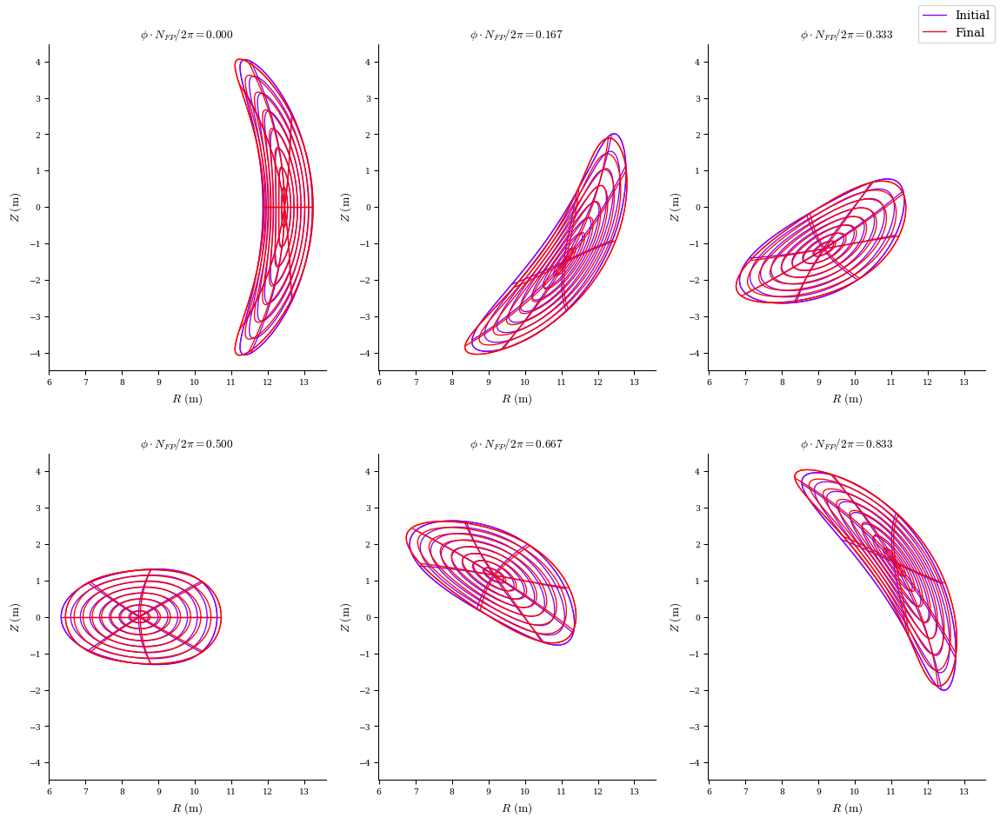

In [8]:
plot_comparison([eqi_scaled, eq], labels=["Initial", "Final"]);

In [9]:
# eq.save("precise_qa_particle_1e-5_10iter.h5")

In [10]:
ts = np.linspace(0, 1e-5, 1000)
fig = plot_3d(eq, "|B|", alpha=0.3)
fig, data1 = plot_particle_trajectories(
    eq,
    model_flux,
    particles_flux,
    ts,
    fig=fig,
    min_step_size=dt,
    color="blue",
    return_data=True,
)

fig2 = plot_3d(eqi_scaled, "|B|", alpha=0.3)
fig2, data2 = plot_particle_trajectories(
    eqi_scaled,
    model_flux,
    particles_flux,
    ts,
    fig=fig2,
    min_step_size=dt,
    color="red",
    return_data=True,
)

/CODES/DESC/desc/utils.py:572: UserWarning: Unequal number of field periods for grid 1 and basis 2.
  warnings.warn(msg, err)
/CODES/DESC/desc/utils.py:572: UserWarning: Unequal number of field periods for grid 1 and basis 2.
  warnings.warn(msg, err)
/CODES/DESC/desc/utils.py:572: UserWarning:

Unequal number of field periods for grid 1 and basis 2.

/CODES/DESC/desc/utils.py:572: UserWarning:

Unequal number of field periods for grid 1 and basis 2.



In [11]:
# fig.write_html("optimized_particle_orbits.html")
fig

In [ ]:
# fig.write_html("unoptimized_particle_orbits.html")
fig2

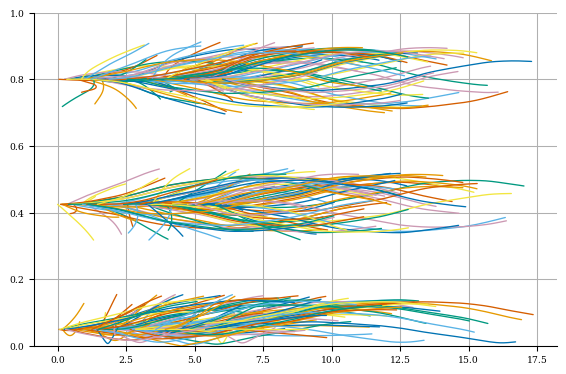

In [13]:
for i, (rhos, phis) in enumerate(zip(data1["rho"], data1["phi"])):
    plt.plot(phis, rhos)
plt.ylim([0,1])
plt.grid()

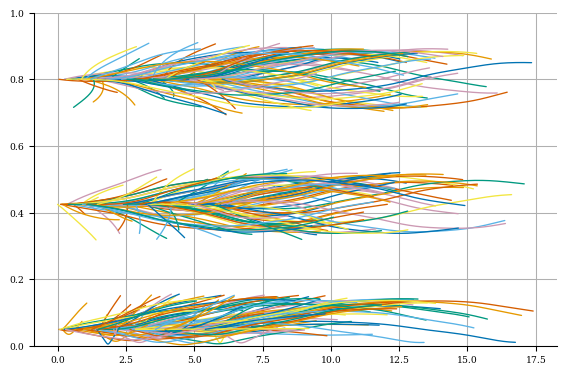

In [14]:
for i, (rhos, phis) in enumerate(zip(data2["rho"], data2["phi"])):
    plt.plot(phis, rhos)
plt.ylim([0, 1])
plt.grid()